In [3]:
from transformers import AutoModelForCausalLM, AutoTokenizer

model_name = "Qwen/Qwen2.5-3B-Instruct"

model = AutoModelForCausalLM.from_pretrained(
    model_name,
    torch_dtype="auto",
    device_map="cpu"
)
tokenizer = AutoTokenizer.from_pretrained(model_name)

c:\Users\Estudiante TFM\VR-Interaction\.venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Loading checkpoint shards: 100%|██████████| 2/2 [00:00<00:00,  4.61it/s]


In [2]:
nameCounters = {}

def generatedId(name):
    if name not in nameCounters:
        nameCounters[name] = 1
    else:
        nameCounters[name] += 1
    return f"{name}{nameCounters[name]}"

In [1]:
from backend.qwen_model import qwen_model

async def extract_name(task):
    prompt = f"""
    You are an expert in extracting the name of the main object the user wants to create based on their request.
    Your task is to extract ONLY the name of the main object.

    Do not include any descriptions, attributes, or properties, such as color, height, or size.
    Do not include words like "model".

    Return only the single name of the object, and nothing else.
    The name MUST be a NOUN.
    
    User's request: {task}
    """
    messages = [
        {"role": "system", "content": "You are an AI assistant designed to help users extract the name of the main object based on their request."},
        {"role": "user", "content": prompt}
    ]
    name = await qwen_model(messages)
    print("Extracted name: ", name.strip())
    return name.strip().replace(" ", "_")

In [5]:
queries = [
    "Place a brown rectangle coffee table in the middle of the room.", 
    "Create a short table.",
    "Place a 2x2 meter table in front of me.",
    "Slightly to the left of the table and closer to me, generate a chair with the top being green plastic and 4 wooden legs.",
    "Create five cubes, each a different color.",
    "Place chairs around the table in a circular pattern.",
    "Drop a black color table in front of me.",
    "Please place a coffee table there.",
    "Create a medieval table with chairs around it."]

In [3]:
for query in queries:
    print(f"Query: {query}")
    name = await extract_name(query)
    print(f"Extracted name: {name}\n")

Query: Place a brown rectangle coffee table in the middle of the room.
Extracted name:  coffee table
Extracted name: coffee_table

Query: Create a short table.
Extracted name:  table
Extracted name: table

Query: Place a 2x2 meter table in front of me.
Extracted name:  table
Extracted name: table

Query: Slightly to the left of the table and closer to me, generate a chair with the top being green plastic and 4 wooden legs.
Extracted name:  chair
Extracted name: chair

Query: Create five cubes, each a different color.
Extracted name:  cube
Extracted name: cube

Query: Place chairs around the table in a circular pattern.
Extracted name:  table
Extracted name: table

Query: Drop a black color table in front of me.
Extracted name:  table
Extracted name: table

Query: Please place a coffee table there.
Extracted name:  coffee table
Extracted name: coffee_table

Query: Create a medieval table with chairs around it.
Extracted name:  table
Extracted name: table



In [ ]:
def define_position(question, semantic_graph, spatial_relationships):
    """
    Define the position of an object based on the question, environment, and spatial relationships.
    """
    prompt = f"""
    You are an expert in determining the 3D position of an object based on user instructions, a semantic graph of a 3D scene, and spatial relationships between objects (all interpreted relative to the user's perspective and orientation).

    Your task:
    Given a user's question, the semantic graph, and spatial relationships, compute the appropriate 3D position for the requested object and return it in the format:
    {{ "x": <x_value>, "y": <y_value>, "z": <z_value> }}

    Only return the JSON object. No explanation.

    --- Instructions ---
    1. Identify the reference object(s) mentioned in the question.
    2. Retrieve their position from the semantic graph.
    3. Apply the appropriate directional offset based on the user's instruction.

    --- Directional Offsets ---
    (For object-based references)
    - "Right of [object]" → x + 1
    - "Left of [object]" → x - 1
    - "On top of [object]" → y + 1
    - "Below [object]" → y - 1
    - "In front of [object]" → z + 1
    - "Behind [object]" → z - 1

    (For user-based references)
    - "Right of me" → user.x + 1
    - "Left of me" → user.x - 1
    - "On top of me" → user.y + 1
    - "Below me" → user.y - 1
    - "Behind me" → user.z + 1
    - "In front of me" → user.z - 1

    - "Next to [object]" → default to x + 1 unless otherwise specified.
    - If direction is ambiguous or unspecified, use x-axis as default.
    - Prioritize direction interpretation in the following order: front/behind > left/right > top/below.

    --- Reasoning Instructions ---
    Think step by step before responding:
    1. Identify the reference object mentioned in the question.
    2. Retrieve the position from the semantic graph.
    3. Analyze the spatial instruction (e.g., "on top of", "next to", "behind").
    4. Apply the corresponding directional offset (modify only one coordinate) to compute the new position.
    5. Return only the final result in the format: {{ "x": <x_value>, "y": <y_value>, "z": <z_value> }}

    --- INPUTS ---
    Question: {question}
    Semantic Graph: {semantic_graph}
    Global Spatial Relationships: {spatial_relationships}

    --- OUTPUT FORMAT ---
    {{ "x": <x_value>, "y": <y_value>, "z": <z_value> }}


    --- EXAMPLE ---
    Semantic Graph: [
        {{
            "id": "user",
            "type": "user",
            "color": "none",
            "position": {{
            "x": -1,
            "y": 0,
            "z": 1
            }}
        }},
        {{
            "id": "table1",
            "type": "table",
            "color": "brown",
            "position": {{
            "x": -2,
            "y": 1,
            "z": 0
            }},
        {{
            "id": "sofa1",
            "type": "sofa",
            "color": "white",
            "position": {{
            "x": -1,
            "y": 0,
            "z": -2
            }}
        }}
        }}
    ]
    Global Spatial Relationships:
    - user is in front of and to the right of and below table1
    - table1 is behind and to the left of and above user
    - user is in front of sofa1
    - sofa1 is behind user
    - table1 is in front and to the left and above sofa1
    - sofa1 is behind and to the right and below table1
     
    Question: "Create a chair next to the table."
    Response: {{ "x": -1, "y": 1, "z": 0 }}

    Question: "Create a chair to the right of the sofa."
    Response: {{ "x": 0, "y": 0, "z": -2 }}

    Question: "Move the sofa to the left of the table."
    Response: {{ "x": -3, "y": 1, "z": 0 }}

    Question: "Create a chair on top of the table."
    Response: {{ "x": -2, "y": 2, "z": 0 }}

    Question: "Move the table behind the sofa."
    Response: {{ "x": -1, "y": 0, "z": -3 }}

    Question: "Create a chair in front of me."
    Response: {{ "x": -1, "y": 0, "z": 0 }}
    """
    messages = [
        {"role": "system", "content": "You are an AI assistant designed to determine the 3D position of an object based on user instructions, a semantic graph of a 3D scene, and spatial relationships between objects."},
        {"role": "user", "content": prompt}
    ]
    text = tokenizer.apply_chat_template(
        messages,
        tokenize=False,
        add_generation_prompt=True
    )
    model_inputs = tokenizer([text], return_tensors="pt").to(model.device)

    generated_ids = model.generate(
        **model_inputs,
        max_new_tokens=512
    )
    generated_ids = [
        output_ids[len(input_ids):] for input_ids, output_ids in zip(model_inputs.input_ids, generated_ids)
    ]

    position = tokenizer.batch_decode(generated_ids, skip_special_tokens=True)[0]
    return position

In [13]:
semantic_graph = [
        {
            "id": "user",
            "type": "user",
            "color": "none",
            "position": {
            "x": -1,
            "y": 0,
            "z": 0
            }
        },
        {
            "id": "table1",
            "type": "table",
            "color": "brown",
            "position": {
            "x": -2,
            "y": 1,
            "z": 0
            }
        },
        {
            "id": "camera1",
            "type": "camera",
            "color": "gray",
            "position": {
            "x": -1,
            "y": 0,
            "z": -2
            }
        },
    ]
spatial_relationships = """
 - user is to the right of and below table1
 - table1 is to the left of and above user
 - user is in front of camera1
 - camera1 is behind user
 - table1 is in front of and to the left of and above camera1
 - camera1 is behind and to the right of and below table1
 """

In [ ]:
position = define_position("Create a chair on top of me.", semantic_graph, spatial_relationships) # good but moves it behind the user
print(f"Position of the chair: {position}")

position = define_position("Move the camera above me.", semantic_graph, spatial_relationships) # wrong moves it in front of the user
print(f"Position of the chair: {position}")

position = define_position("Place a car behind me.", semantic_graph, spatial_relationships) # good but moves it to the left
print(f"Position of the car: {position}")

position = define_position("Create a chair next to me.", semantic_graph, spatial_relationships) # wrong moves it to the left instead of right
print(f"Position of the chair: {position}")

position = define_position("Create a door to my left.", semantic_graph, spatial_relationships) # good
print(f"Position of the door: {position}")

position = define_position("Create a door to the right of me.", semantic_graph, spatial_relationships) # wrong moves it to the left instead of right
print(f"Position of the door: {position}")

position = define_position("Move the table to the right of me.", semantic_graph, spatial_relationships) # good
print(f"Position of the table: {position}")

position = define_position("Create a door to the right of the table.", semantic_graph, spatial_relationships) # wrong moves it to in front instead of right
print(f"Position of the door: {position}")

position = define_position("Create a door to my right.", semantic_graph, spatial_relationships) # wrong moves it to the left instead of right, and behind
print(f"Position of the door: {position}")

Position of the chair: { "x": -1, "y": 1, "z": 1 }
Position of the chair: { "x": -1, "y": 0, "z": -1 }
Position of the car: { "x": -2, "y": 0, "z": 1 }
Position of the chair: { "x": -2, "y": 0, "z": 0 }
Position of the door: { "x": -2, "y": 0, "z": 0 }
Position of the door: { "x": -2, "y": 0, "z": 0 }
Position of the table: { "x": 0, "y": 0, "z": 0 }
Position of the door: { "x": -2, "y": 1, "z": 1 }
Position of the door: { "x": -2, "y": 0, "z": 1 }


User : (-1, 0, 0)

Table : (-2, 1, 0)

Sofa : (-1, 0, -2)

- "Right of [object]" → x + 1
- "Left of [object]" → x - 1
- "On top of [object]" → y + 1
- "Below [object]" → y - 1
- "In front of [object]" → z + 1, User: z- 1
- "Behind [object]" → z - 1, User: z + 1

In [53]:
def define_object(task, question, properties, path, semantic_graph, spatial_relationships):
    name = extract_name(task)
    object_id = generatedId(name)
    object_properties = {
        "id": object_id,
        "name": name,
        "color": properties.get("color", "unknown"),
        "path": path,
        "position": define_position(question, semantic_graph, spatial_relationships),
    }
    return object_properties

In [ ]:
object_properties = define_object(
    task="Create a table.",
    question="Create a table on top of the desk.",
    properties={"color": "brown"},
    path="/path/to/table/model",
    semantic_graph=semantic_graph,
    spatial_relationships=spatial_relationships
)
print(f"Defined object properties: {object_properties}")


Defined object properties: {'id': 'chair1', 'name': 'chair', 'color': 'brown', 'path': '/path/to/table/model', 'position': '{ "x": -2, "y": 5, "z": 0 }'}


In [16]:
import torch
from diffusers import StableDiffusionPipeline
from io import BytesIO

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
sd_pipe = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2", torch_dtype=torch.float16, cache_dir="/mnt/shared_models/huggingface/cache/hub")
sd_pipe = sd_pipe.to(device)

def generate_image(object_name, pipe):
    """
    Generate a stylized 3D render of the specified object using Stable Diffusion.
    """
    prompt = f"A stylized 3D render of an entire {object_name}, centered, non-cropped isolated on a plain background, realistic, game asset style, VR-ready, high contrast, soft shadows, consistent lighting, clean silhouette, front 3/4 view."
    image = pipe(prompt).images[0]
    image.save(f"images/{object_name}.png".replace(" ", "_"))
    # Convert image to bytes
    buffered = BytesIO()
    image.save(buffered, format="PNG")
    image_bytes = buffered.getvalue()
    return list(image_bytes), f"images/{object_name}.png".replace(" ", "_")

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [14]:
from backend.qwen_model import qwen_model

async def select_object(task):
    """
    This function selects an object based on the provided question and task.
    """
    prompt = f"""
    You are an expert in selecting the object that needs to be created, given a query.
    Query: {task}

    Return ONLY the name of the object that needs to be created.
    If defined in the text, include its properties like color, size, material, etc.
    Otherwise, only return the name.

    Here's an example:
    Task: "Create a red table model."
    
    Response format: "red table"
    """
    messages = [
        {"role": "system", "content": "You are an AI assistant designed to help users extract the object they need to create in a VR environment."},
        {"role": "user", "content": prompt}
    ]
    object = await qwen_model(messages)
    if not object:
        return "unknown object"
    return object.strip()

In [17]:
for query in queries:
    print(f"Query: {query}")
    object_name = await select_object(query)
    print(f"Selected Object: {object_name}")
    generate_image(object_name, sd_pipe)

Query: Place a brown rectangle coffee table in the middle of the room.
Selected Object: brown rectangle coffee table


  0%|          | 0/50 [00:00<?, ?it/s]

Query: Create a short table.
Selected Object: short table


  0%|          | 0/50 [00:00<?, ?it/s]

Query: Place a 2x2 meter table in front of me.
Selected Object: 2x2 meter table


  0%|          | 0/50 [00:00<?, ?it/s]

Query: Slightly to the left of the table and closer to me, generate a chair with the top being green plastic and 4 wooden legs.
Selected Object: green plastic chair with 4 wooden legs


  0%|          | 0/50 [00:00<?, ?it/s]

Query: Create five cubes, each a different color.
Selected Object: five colored cubes


  0%|          | 0/50 [00:00<?, ?it/s]

Query: Place chairs around the table in a circular pattern.
Selected Object: chairs


  0%|          | 0/50 [00:00<?, ?it/s]

Query: Drop a black color table in front of me.
Selected Object: black table


  0%|          | 0/50 [00:00<?, ?it/s]

Query: Please place a coffee table there.
Selected Object: coffee table


  0%|          | 0/50 [00:00<?, ?it/s]

Query: Create a medieval table with chairs around it.
Selected Object: medieval table with chairs


  0%|          | 0/50 [00:00<?, ?it/s]

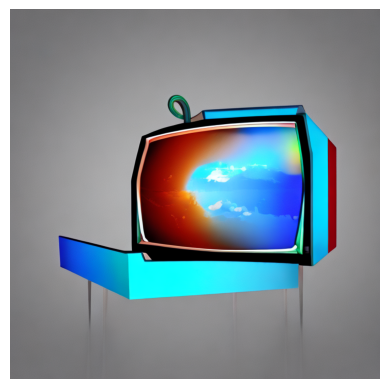

Generating tv1 3D model...
tv1 took 0 mins 52 secs to be generated.

3D model saved to ../models/tv1.glb


In [4]:
from image_to_3D import generate_3D_model
import os
from PIL import Image

images = ["../images/tv1.png"]
for image in images:
    import matplotlib.pyplot as plt

    img = Image.open(image)
    plt.imshow(img)
    plt.axis('off')
    plt.show()
    object_id = os.path.splitext(os.path.basename(image))[0].replace(".png", "")
    await generate_3D_model(image, object_id)
    

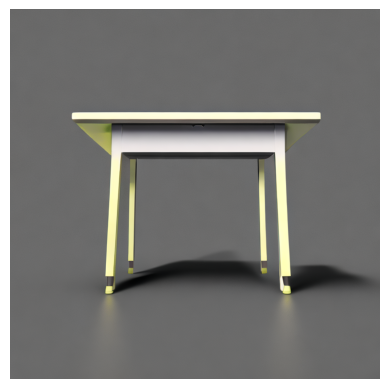

Generating desk1 3D model...
desk1 took 2 mins 15 secs to be generated.

3D model saved to ../models/desk1.glb


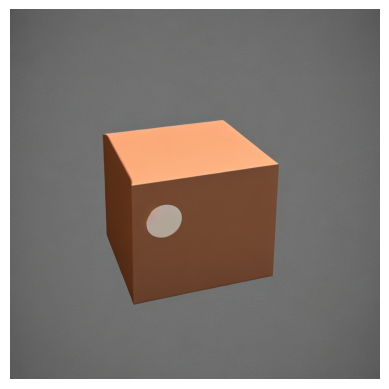

Generating box3 3D model...
box3 took 0 mins 19 secs to be generated.

3D model saved to ../models/box3.glb


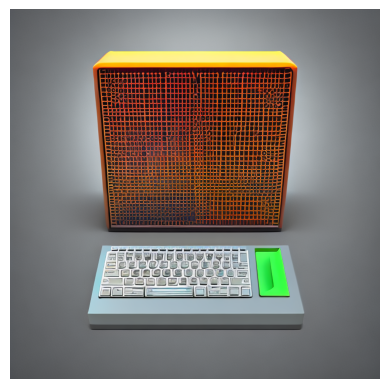

Generating computer1 3D model...
computer1 took 1 mins 6 secs to be generated.

3D model saved to ../models/computer1.glb


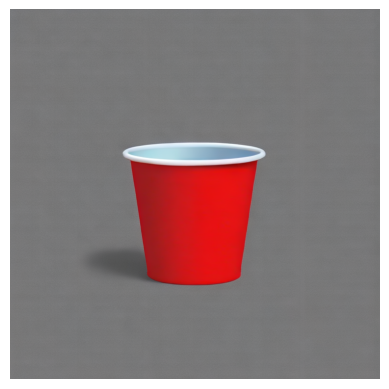

Generating cup1 copy 3D model...
cup1 copy took 2 mins 49 secs to be generated.

3D model saved to ../models/cup1_copy.glb


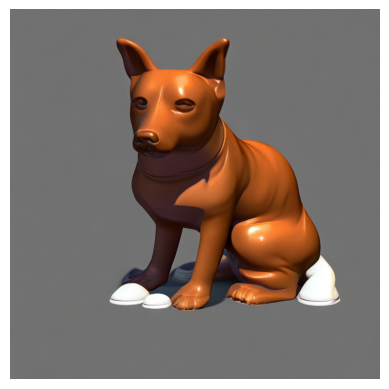

Generating dog_statue1 3D model...
dog_statue1 took 1 mins 35 secs to be generated.

3D model saved to ../models/dog_statue1.glb


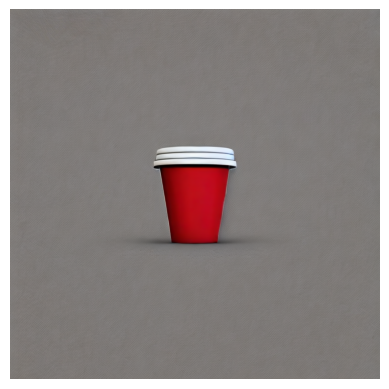

Generating cup1 3D model...
cup1 took 1 mins 4 secs to be generated.

3D model saved to ../models/cup1.glb


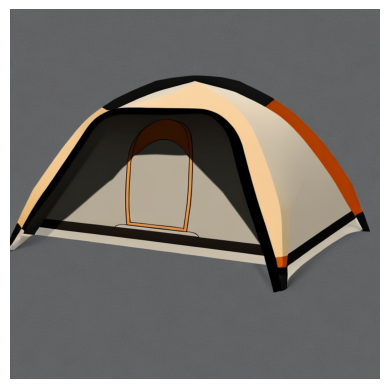

Generating campsite1 3D model...
campsite1 took 0 mins 48 secs to be generated.

3D model saved to ../models/campsite1.glb


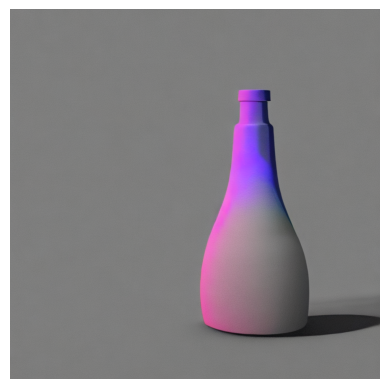

Generating bottle1 3D model...
bottle1 took 0 mins 34 secs to be generated.

3D model saved to ../models/bottle1.glb


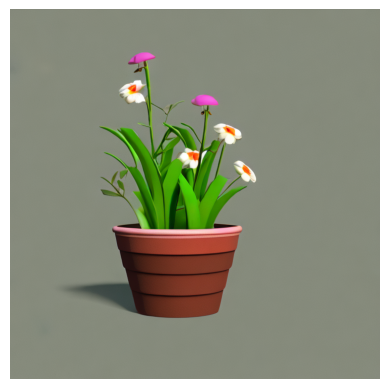

Generating flower_pot1 3D model...
flower_pot1 took 5 mins 55 secs to be generated.

3D model saved to ../models/flower_pot1.glb


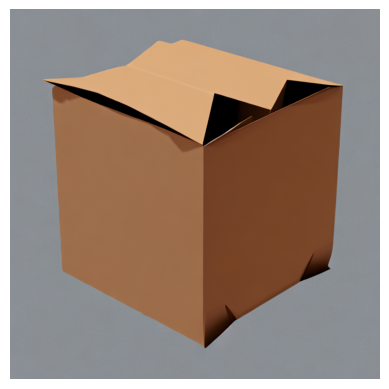

Generating box1 3D model...
box1 took 1 mins 1 secs to be generated.

3D model saved to ../models/box1.glb


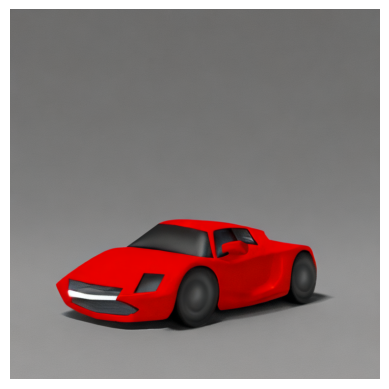

Generating car2 3D model...
car2 took 1 mins 10 secs to be generated.

3D model saved to ../models/car2.glb


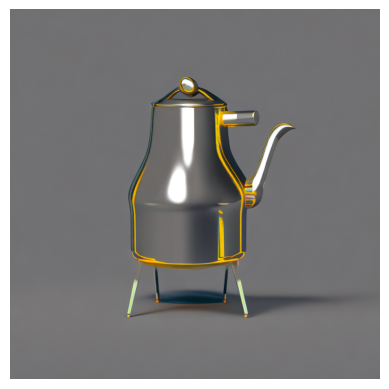

Generating kettle1 3D model...
kettle1 took 0 mins 55 secs to be generated.

3D model saved to ../models/kettle1.glb


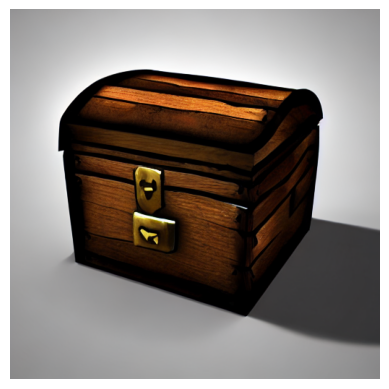

Generating chest_compvis 3D model...
chest_compvis took 0 mins 53 secs to be generated.

3D model saved to ../models/chest_compvis.glb


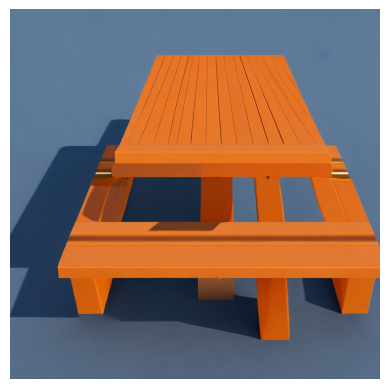

Generating picnic_table1 3D model...
picnic_table1 took 0 mins 16 secs to be generated.

3D model saved to ../models/picnic_table1.glb


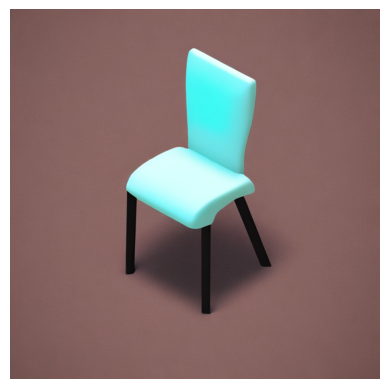

Generating chair3 3D model...
chair3 took 0 mins 54 secs to be generated.

3D model saved to ../models/chair3.glb


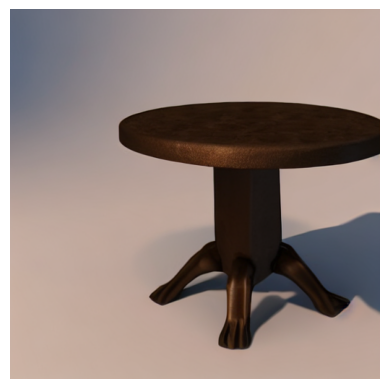

Generating table_compvis 3D model...
table_compvis took 0 mins 41 secs to be generated.

3D model saved to ../models/table_compvis.glb


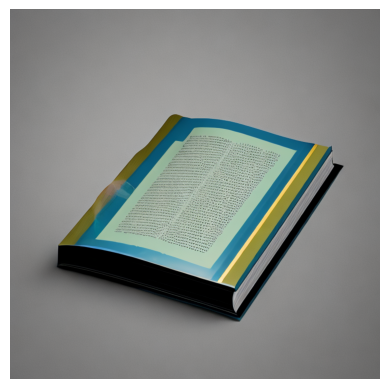

Generating book4 3D model...
book4 took 0 mins 41 secs to be generated.

3D model saved to ../models/book4.glb


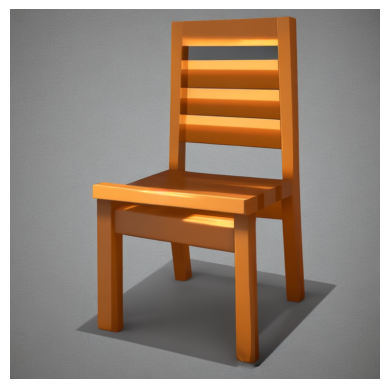

Generating wooden_chair 3D model...
wooden_chair took 2 mins 28 secs to be generated.

3D model saved to ../models/wooden_chair.glb


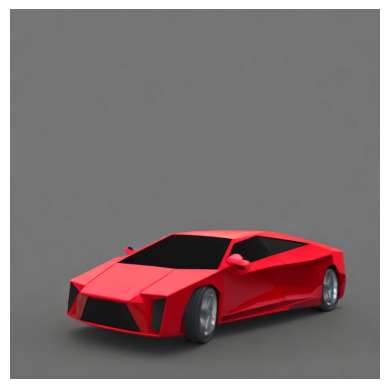

Generating red_car copy 3D model...
red_car copy took 1 mins 36 secs to be generated.

3D model saved to ../models/red_car_copy.glb


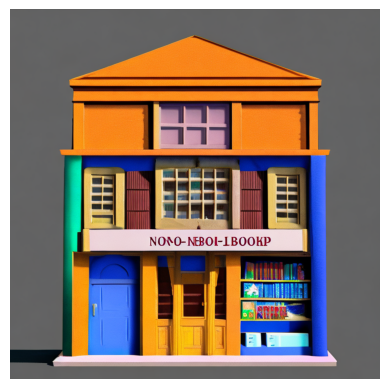

Generating bookshop1 3D model...
bookshop1 took 2 mins 31 secs to be generated.

3D model saved to ../models/bookshop1.glb


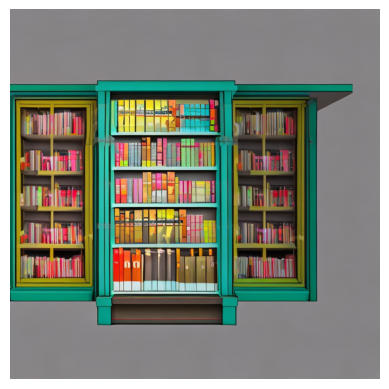

Generating bookshop3 3D model...
bookshop3 took 0 mins 37 secs to be generated.

3D model saved to ../models/bookshop3.glb


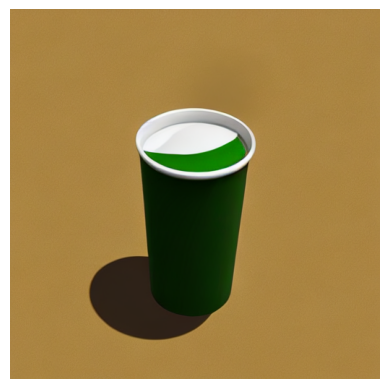

Generating tall green cup of coffee_sd 3D model...
tall green cup of coffee_sd took 0 mins 40 secs to be generated.

3D model saved to ../models/tall_green_cup_of_coffee_sd.glb


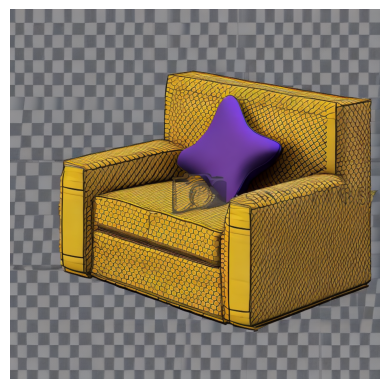

Generating living_room1 3D model...
living_room1 took 1 mins 23 secs to be generated.

3D model saved to ../models/living_room1.glb


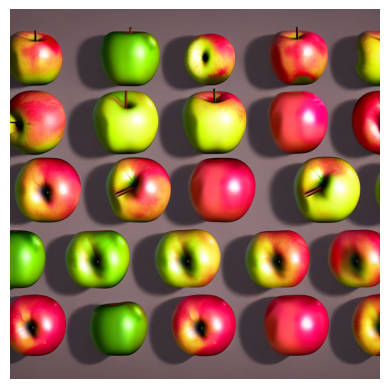

Generating apple1 3D model...
Request failed with status code 404: {"text":"**NETWORK ERROR DUE TO HIGH TRAFFIC. PLEASE REGENERATE OR REFRESH THIS PAGE.**","error_code":1}
apple1 took 0 mins 0 secs to be generated.

Failed to generate 3D model.


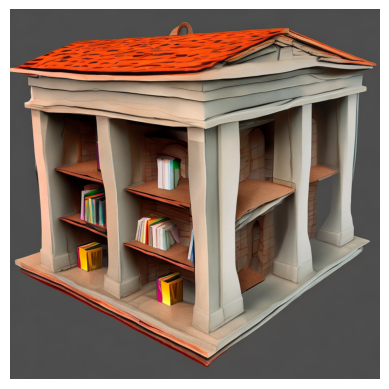

Generating library1 3D model...
library1 took 2 mins 49 secs to be generated.

3D model saved to ../models/library1.glb


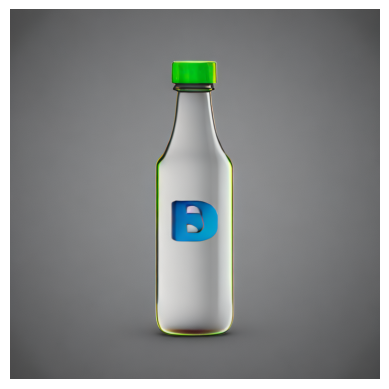

Generating bottle3 3D model...
bottle3 took 1 mins 48 secs to be generated.

3D model saved to ../models/bottle3.glb


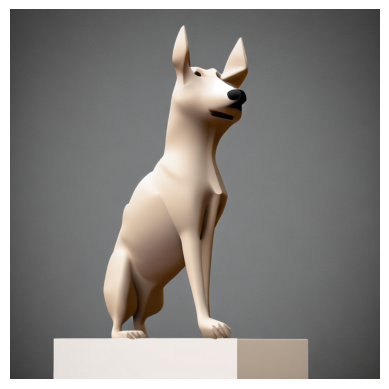

Generating dog_statue2 3D model...
dog_statue2 took 1 mins 53 secs to be generated.

3D model saved to ../models/dog_statue2.glb


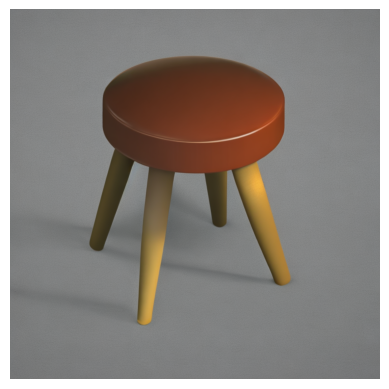

Generating stool1 3D model...
stool1 took 1 mins 12 secs to be generated.

3D model saved to ../models/stool1.glb


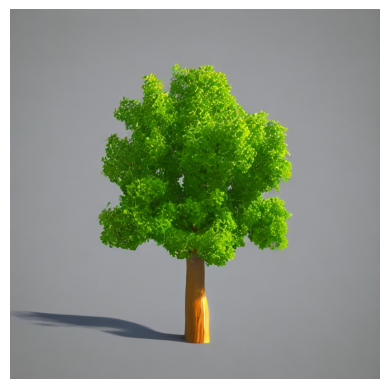

Generating tree2 copy 3D model...
tree2 copy took 6 mins 34 secs to be generated.

3D model saved to ../models/tree2_copy.glb


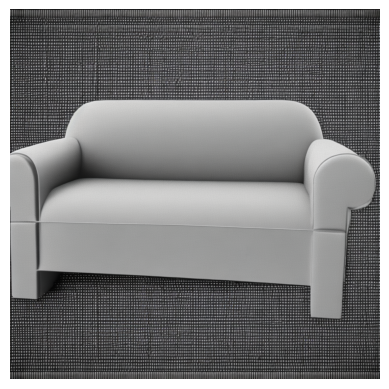

Generating sofa 3D model...
sofa took 1 mins 4 secs to be generated.

3D model saved to ../models/sofa.glb


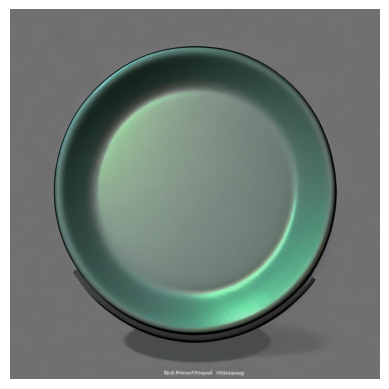

Generating plate1 3D model...
plate1 took 0 mins 31 secs to be generated.

3D model saved to ../models/plate1.glb


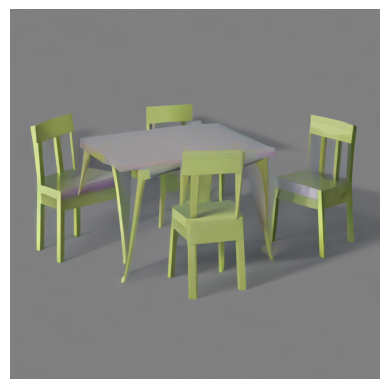

Generating dining_set1 3D model...
dining_set1 took 5 mins 6 secs to be generated.

3D model saved to ../models/dining_set1.glb


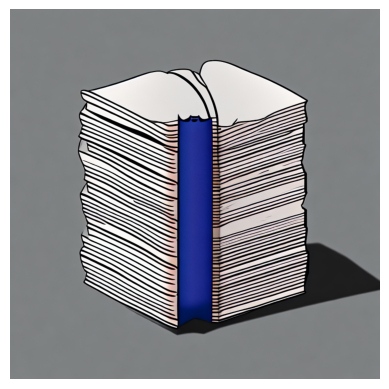

Generating book1 3D model...
Request failed with status code 404: {"text":"**NETWORK ERROR DUE TO HIGH TRAFFIC. PLEASE REGENERATE OR REFRESH THIS PAGE.**","error_code":1}
book1 took 0 mins 0 secs to be generated.

Failed to generate 3D model.


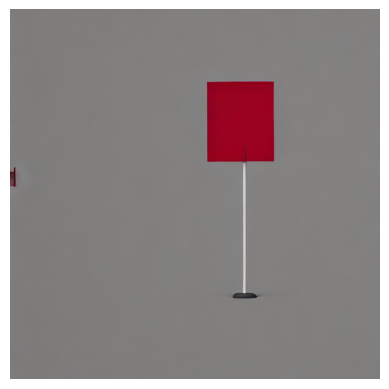

Generating card1 3D model...
card1 took 0 mins 20 secs to be generated.

3D model saved to ../models/card1.glb


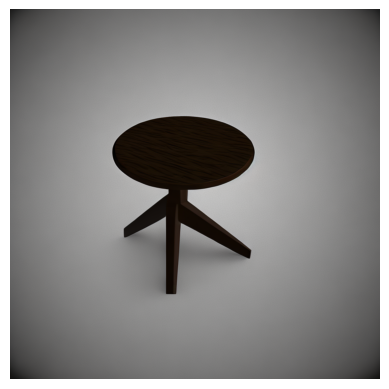

Generating coffee_table 3D model...
coffee_table took 0 mins 54 secs to be generated.

3D model saved to ../models/coffee_table.glb


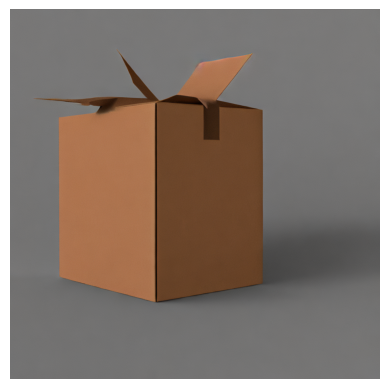

Generating box4 3D model...
box4 took 2 mins 21 secs to be generated.

3D model saved to ../models/box4.glb


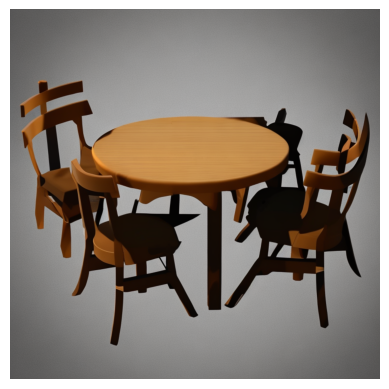

Generating medieval_table_with_chairs 3D model...
medieval_table_with_chairs took 6 mins 35 secs to be generated.

3D model saved to ../models/medieval_table_with_chairs.glb


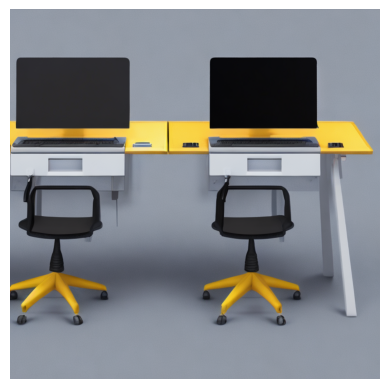

Generating workspace1 3D model...
workspace1 took 3 mins 39 secs to be generated.

3D model saved to ../models/workspace1.glb


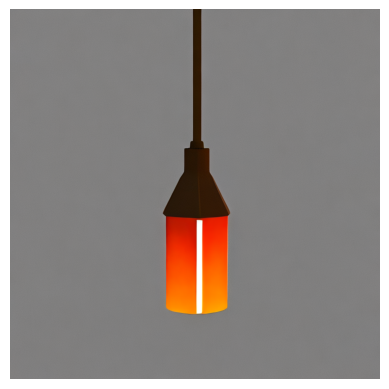

Generating lamp1 3D model...
lamp1 took 0 mins 43 secs to be generated.

3D model saved to ../models/lamp1.glb


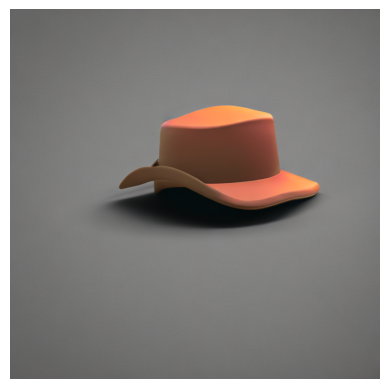

Generating hat1 3D model...
hat1 took 2 mins 32 secs to be generated.

3D model saved to ../models/hat1.glb


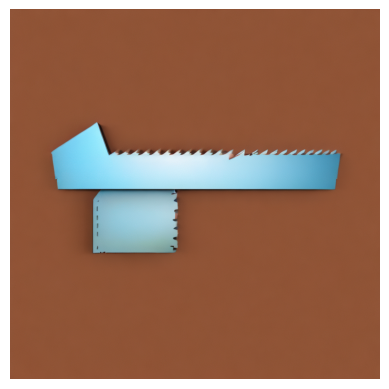

Generating saw1 3D model...
saw1 took 1 mins 37 secs to be generated.

3D model saved to ../models/saw1.glb


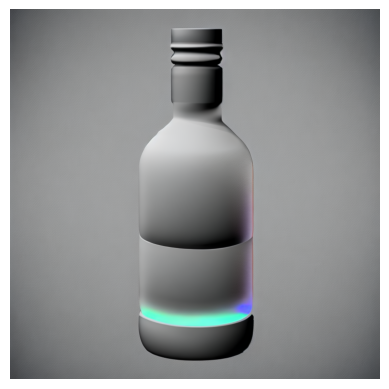

Generating bottle2 3D model...
bottle2 took 1 mins 53 secs to be generated.

3D model saved to ../models/bottle2.glb


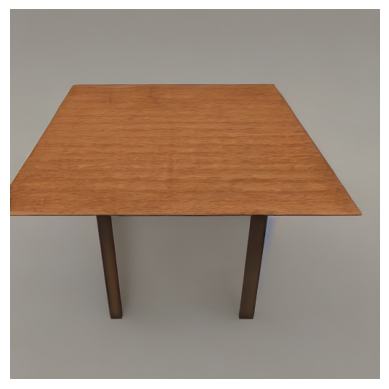

Generating brown_table 3D model...
brown_table took 2 mins 30 secs to be generated.

3D model saved to ../models/brown_table.glb


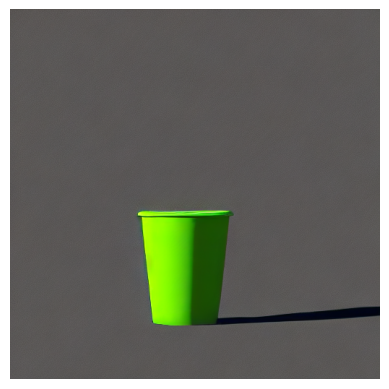

Generating tall green cup of coffee_compvis 3D model...
Request failed with status code 404: {"text":"**NETWORK ERROR DUE TO HIGH TRAFFIC. PLEASE REGENERATE OR REFRESH THIS PAGE.**","error_code":1}
tall green cup of coffee_compvis took 0 mins 0 secs to be generated.

Failed to generate 3D model.


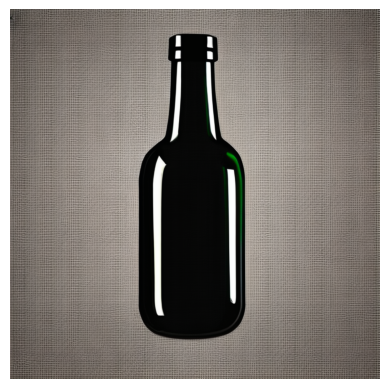

Generating bottle5 3D model...
bottle5 took 0 mins 46 secs to be generated.

3D model saved to ../models/bottle5.glb


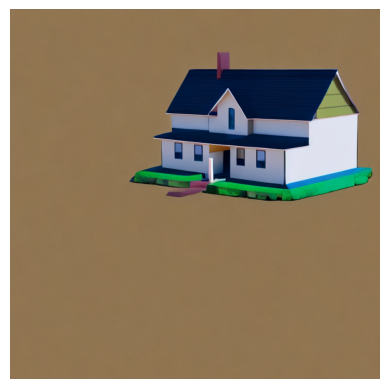

Generating house 3D model...
house took 1 mins 32 secs to be generated.

3D model saved to ../models/house.glb


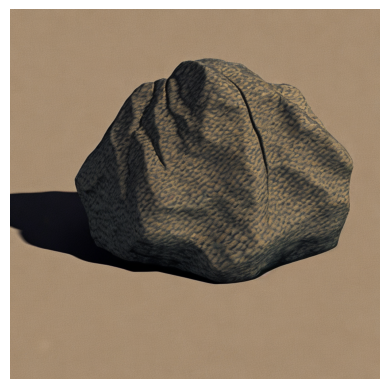

Generating rock1 3D model...
rock1 took 0 mins 50 secs to be generated.

3D model saved to ../models/rock1.glb


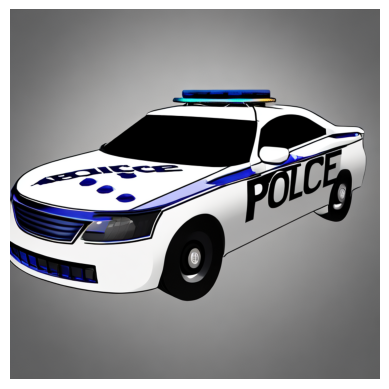

Generating police_car 3D model...
police_car took 1 mins 34 secs to be generated.

3D model saved to ../models/police_car.glb


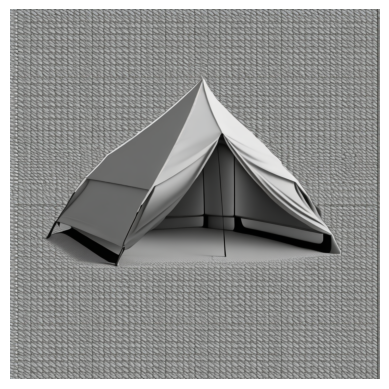

Generating tent 3D model...
tent took 5 mins 18 secs to be generated.

3D model saved to ../models/tent.glb


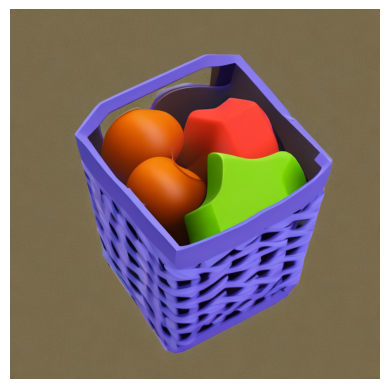

Generating basket2 3D model...
basket2 took 0 mins 26 secs to be generated.

3D model saved to ../models/basket2.glb


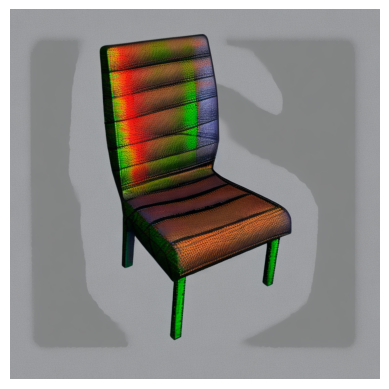

Generating chair1 3D model...
chair1 took 0 mins 44 secs to be generated.

3D model saved to ../models/chair1.glb


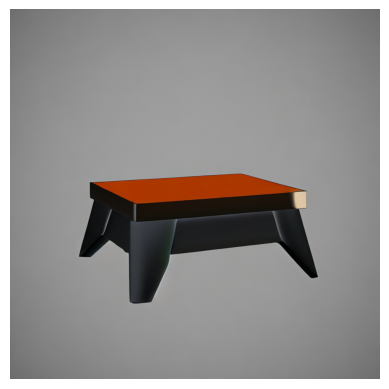

Generating coffee_table1 3D model...
coffee_table1 took 0 mins 43 secs to be generated.

3D model saved to ../models/coffee_table1.glb


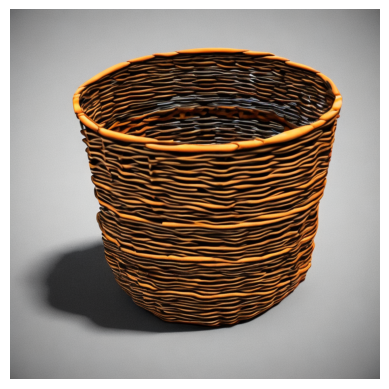

Generating basket1 copy 3D model...
basket1 copy took 12 mins 25 secs to be generated.

3D model saved to ../models/basket1_copy.glb


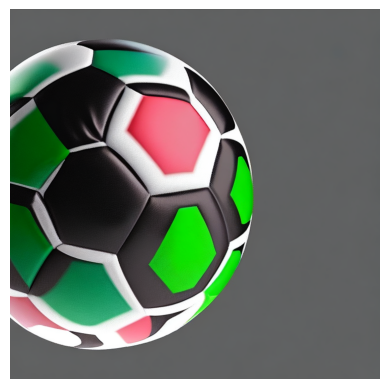

Generating soccer_ball1 3D model...
soccer_ball1 took 0 mins 45 secs to be generated.

3D model saved to ../models/soccer_ball1.glb


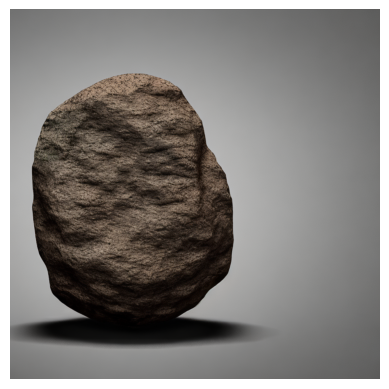

Generating rock3 3D model...
Request failed with status code 404: {"text":"**NETWORK ERROR DUE TO HIGH TRAFFIC. PLEASE REGENERATE OR REFRESH THIS PAGE.**","error_code":1}
rock3 took 0 mins 0 secs to be generated.

Failed to generate 3D model.


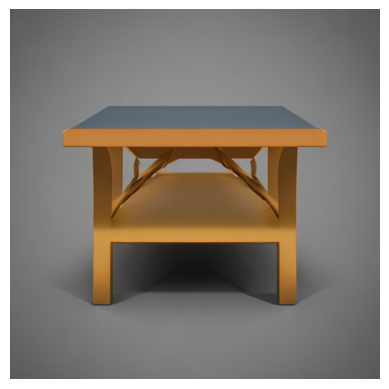

Generating table2 3D model...
table2 took 2 mins 52 secs to be generated.

3D model saved to ../models/table2.glb


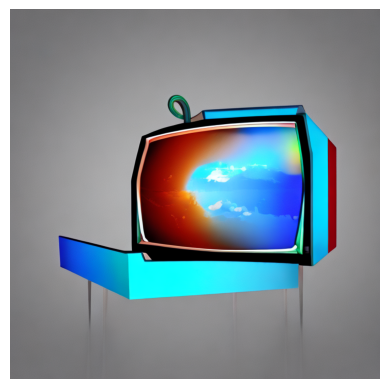

Generating tv1 3D model...
tv1 took 0 mins 53 secs to be generated.

3D model saved to ../models/tv1.glb


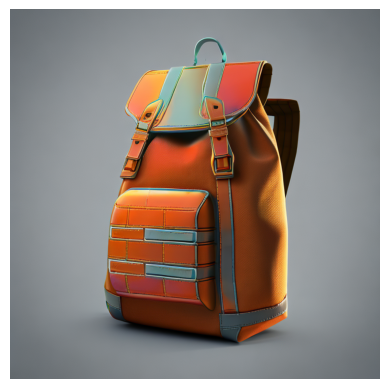

Generating backpack1 3D model...
backpack1 took 3 mins 20 secs to be generated.

3D model saved to ../models/backpack1.glb


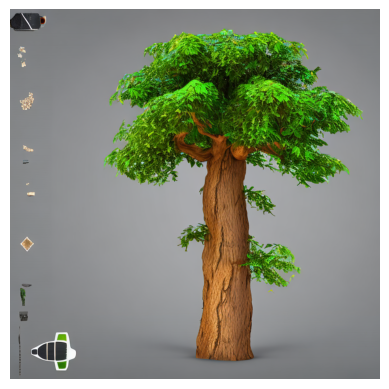

Generating tree2 3D model...
tree2 took 1 mins 27 secs to be generated.

3D model saved to ../models/tree2.glb


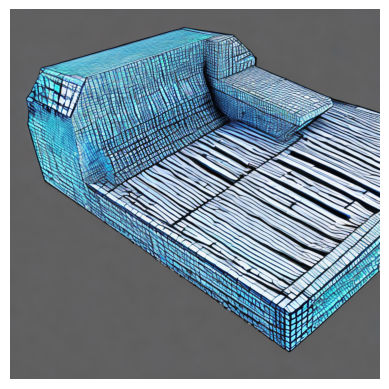

Generating bed1 3D model...
bed1 took 0 mins 34 secs to be generated.

3D model saved to ../models/bed1.glb


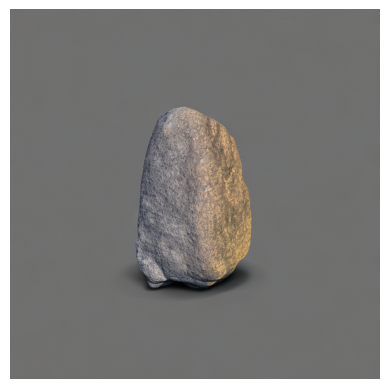

Generating rock2 3D model...
rock2 took 1 mins 15 secs to be generated.

3D model saved to ../models/rock2.glb


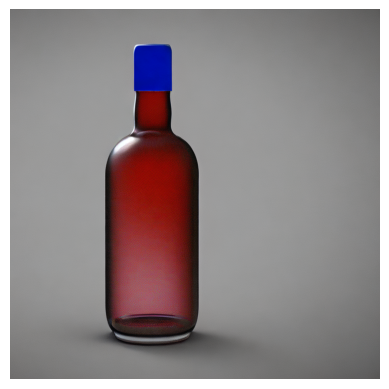

Generating bottle4 3D model...
bottle4 took 1 mins 28 secs to be generated.

3D model saved to ../models/bottle4.glb


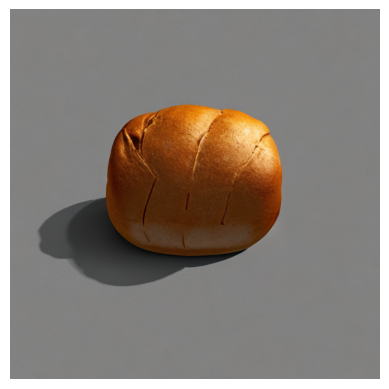

Generating bread1 3D model...
bread1 took 0 mins 30 secs to be generated.

3D model saved to ../models/bread1.glb


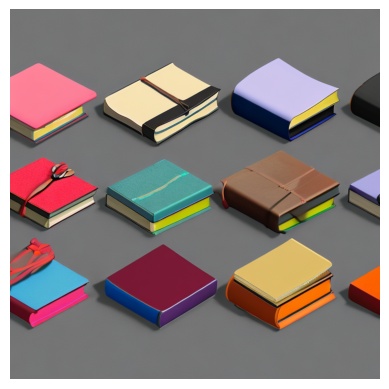

Generating books2 3D model...
books2 took 0 mins 15 secs to be generated.

3D model saved to ../models/books2.glb


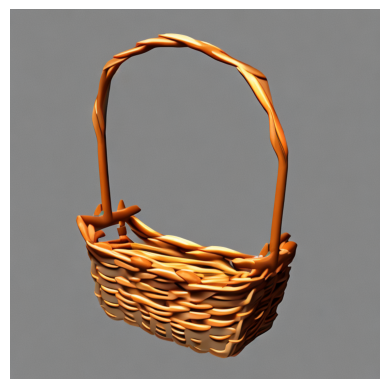

Generating basket1 3D model...
basket1 took 5 mins 6 secs to be generated.

3D model saved to ../models/basket1.glb


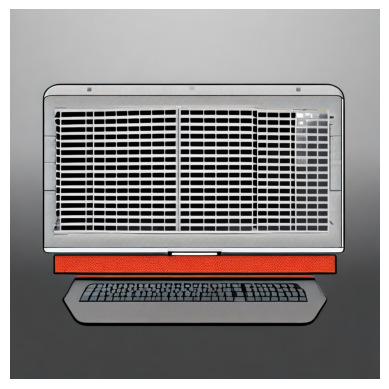

Generating computer2 3D model...
computer2 took 1 mins 2 secs to be generated.

3D model saved to ../models/computer2.glb


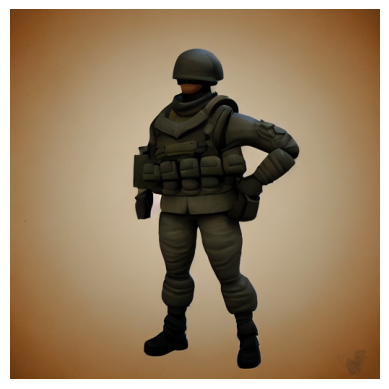

Generating soldier_toy_sd 3D model...
soldier_toy_sd took 3 mins 15 secs to be generated.

3D model saved to ../models/soldier_toy_sd.glb


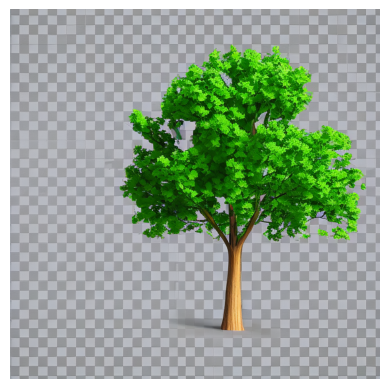

Generating tree1 copy 3D model...
tree1 copy took 8 mins 50 secs to be generated.

3D model saved to ../models/tree1_copy.glb


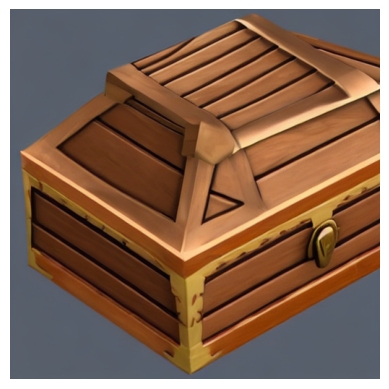

Generating chest_sd 3D model...
chest_sd took 0 mins 40 secs to be generated.

3D model saved to ../models/chest_sd.glb


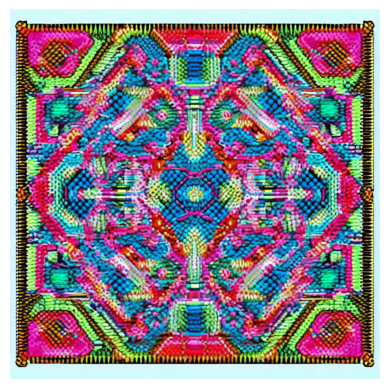

Generating rug1 3D model...
rug1 took 0 mins 20 secs to be generated.

3D model saved to ../models/rug1.glb


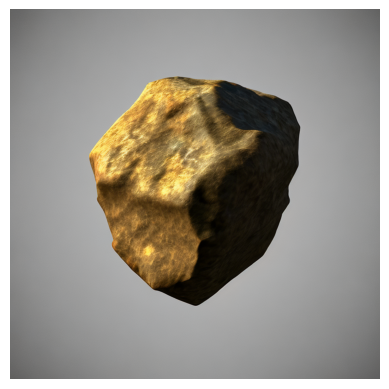

Generating rock4 3D model...
rock4 took 0 mins 35 secs to be generated.

3D model saved to ../models/rock4.glb


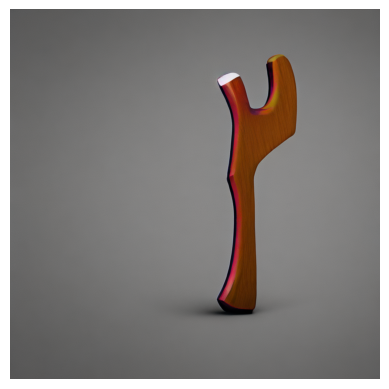

Generating axe1 3D model...
axe1 took 0 mins 51 secs to be generated.

3D model saved to ../models/axe1.glb


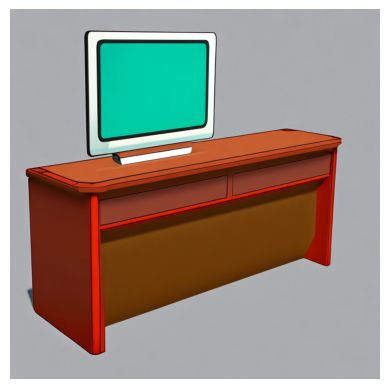

Generating sofa1 3D model...
sofa1 took 0 mins 25 secs to be generated.

3D model saved to ../models/sofa1.glb


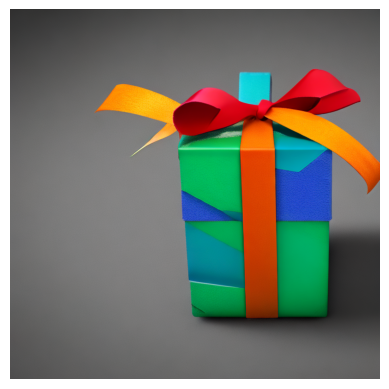

Generating gift1 3D model...
gift1 took 3 mins 29 secs to be generated.

3D model saved to ../models/gift1.glb


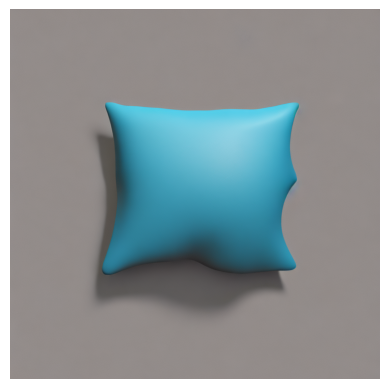

Generating pillow1 3D model...
pillow1 took 0 mins 34 secs to be generated.

3D model saved to ../models/pillow1.glb


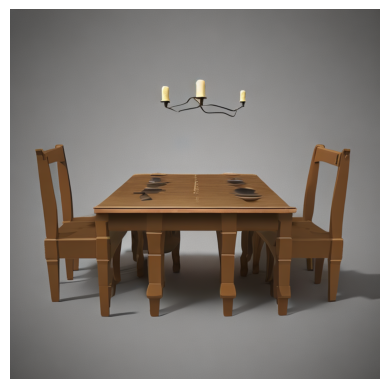

Generating medieval_table_with_chairs copy 3D model...
medieval_table_with_chairs copy took 4 mins 38 secs to be generated.

3D model saved to ../models/medieval_table_with_chairs_copy.glb


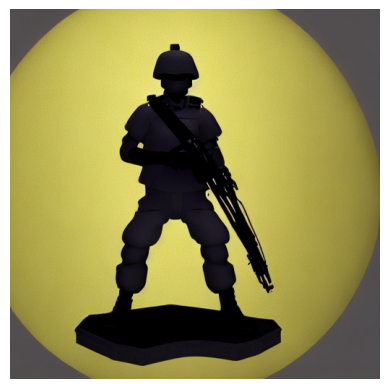

Generating soldier_toy_compvis 3D model...
soldier_toy_compvis took 2 mins 36 secs to be generated.

3D model saved to ../models/soldier_toy_compvis.glb


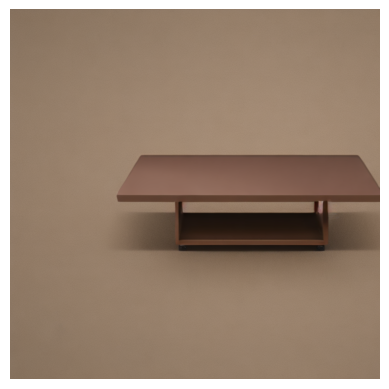

Generating brown_rectangle_coffee_table 3D model...
brown_rectangle_coffee_table took 2 mins 13 secs to be generated.

3D model saved to ../models/brown_rectangle_coffee_table.glb


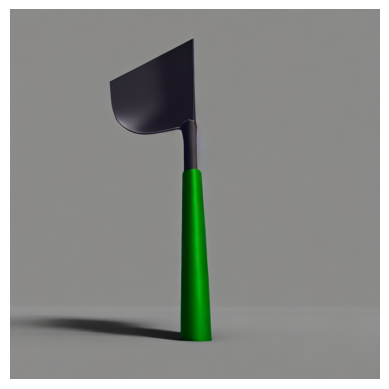

Generating shovel1 3D model...
shovel1 took 0 mins 52 secs to be generated.

3D model saved to ../models/shovel1.glb


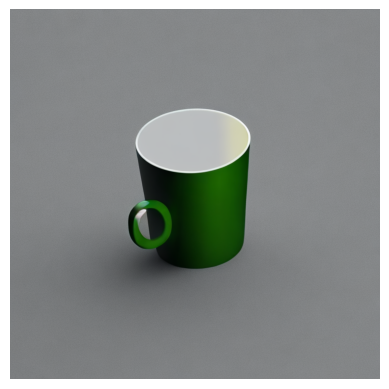

Generating cup1 copy 2 3D model...
cup1 copy 2 took 2 mins 22 secs to be generated.

3D model saved to ../models/cup1_copy_2.glb


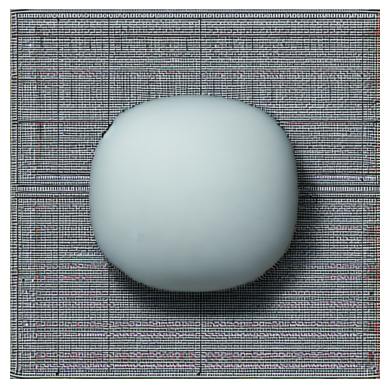

Generating cushion1 3D model...
cushion1 took 0 mins 26 secs to be generated.

3D model saved to ../models/cushion1.glb


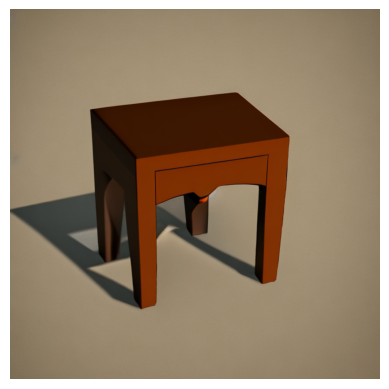

Generating tippy_(side_table) 3D model...
tippy_(side_table) took 1 mins 7 secs to be generated.

3D model saved to ../models/tippy_(side_table).glb


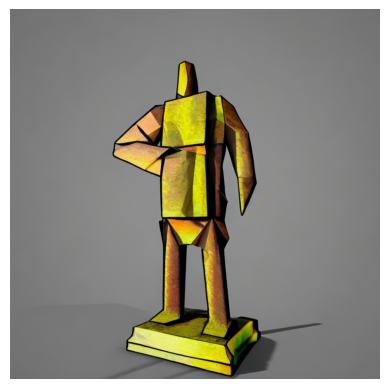

Generating statue1 3D model...
statue1 took 1 mins 54 secs to be generated.

3D model saved to ../models/statue1.glb


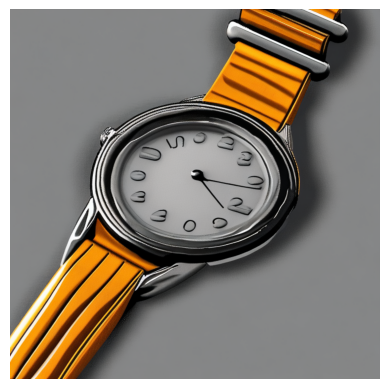

Generating watch1 3D model...
watch1 took 3 mins 7 secs to be generated.

3D model saved to ../models/watch1.glb


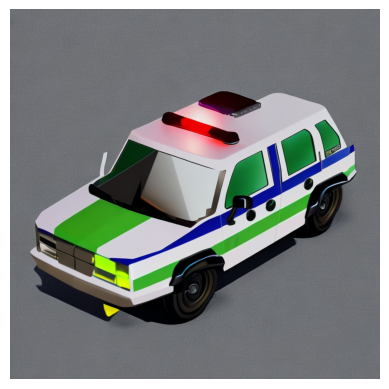

Generating car1 copy 3D model...
car1 copy took 3 mins 5 secs to be generated.

3D model saved to ../models/car1_copy.glb


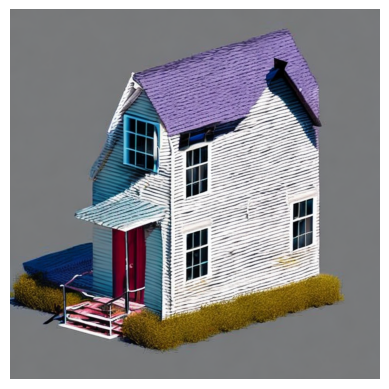

Generating house1 3D model...
house1 took 1 mins 39 secs to be generated.

3D model saved to ../models/house1.glb


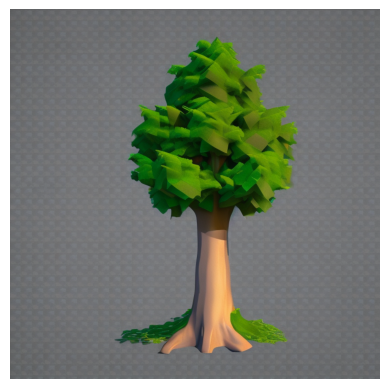

Generating tree1 3D model...
tree1 took 6 mins 40 secs to be generated.

3D model saved to ../models/tree1.glb


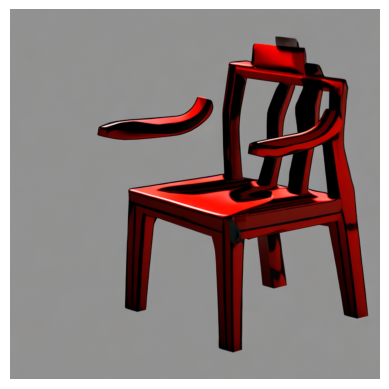

Generating chair2 3D model...
chair2 took 2 mins 11 secs to be generated.

3D model saved to ../models/chair2.glb


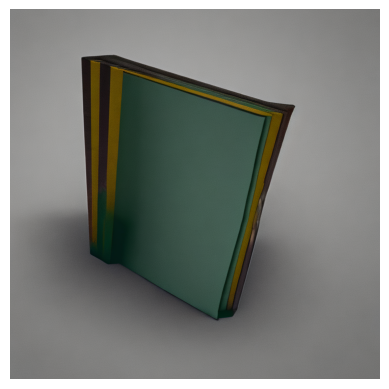

Generating book2 3D model...
book2 took 0 mins 38 secs to be generated.

3D model saved to ../models/book2.glb


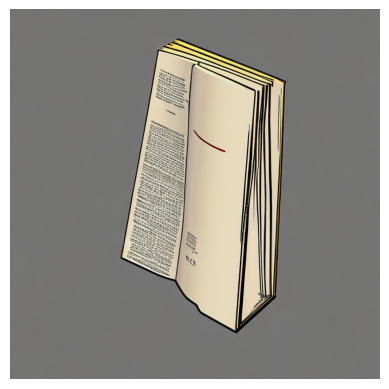

Generating book1 copy 3D model...
book1 copy took 0 mins 35 secs to be generated.

3D model saved to ../models/book1_copy.glb


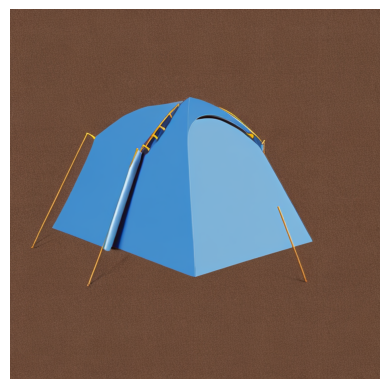

Generating tent1 3D model...
tent1 took 2 mins 29 secs to be generated.

3D model saved to ../models/tent1.glb


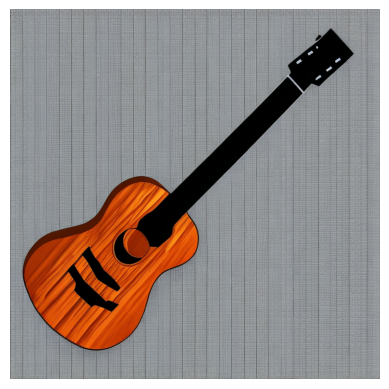

Generating guitar1 3D model...
guitar1 took 0 mins 29 secs to be generated.

3D model saved to ../models/guitar1.glb


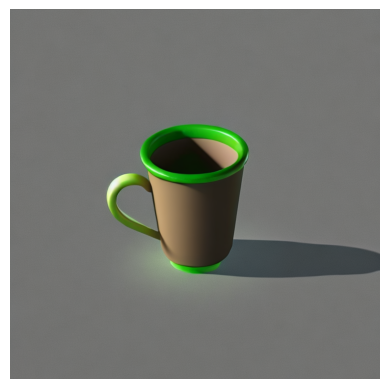

Generating cup2 3D model...
cup2 took 2 mins 21 secs to be generated.

3D model saved to ../models/cup2.glb


In [1]:
from image_to_3D import generate_3D_model
import os
from PIL import Image

images_path = "../images/"
images = [os.path.join(images_path, fname) for fname in os.listdir(images_path) if fname.endswith(".png")]

for image in images:
    import matplotlib.pyplot as plt

    img = Image.open(image)
    plt.imshow(img)
    plt.axis('off')
    plt.show()
    object_id = os.path.splitext(os.path.basename(image))[0].replace(".png", "")
    await generate_3D_model(image, object_id)
    